In [1]:
import scanpy as sc
import numpy as np

In [2]:
os_path="d/"
test_obj = sc.read_h5ad(f'/mnt/{os_path}Radboud/papers/metaatlas/cornea_v1_nonraw.h5ad')
test_obj

AnnData object with n_obs × n_vars = 65036 × 27656
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'RNA_snn_res.0.15', 'seurat_clusters', 'costum_clustering', 'Condition', 'pANN_0.25_0.06_1806', 'DF.classifications_0.25_0.06_1806', 'pANN_0.25_0.005_1289', 'DF.classifications_0.25_0.005_1289', 'RNA_snn_res.0.1', 'pANN_0.25_0.18_1347', 'DF.classifications_0.25_0.18_1347', 'pANN_0.25_0.14_831', 'DF.classifications_0.25_0.14_831', 'batch', '_scvi_batch', '_scvi_labels', 'leiden', 'leiden_0.0', 'leiden_0.05', 'leiden_0.1', 'leiden_0.15', 'leiden_0.2', 'leiden_0.25', 'leiden_0.3', 'leiden_0.35', 'leiden_0.4', 'leiden_0.45', 'leiden_0.5', 'leiden_0.55', 'leiden_0.6', 'leiden_0.65', 'leiden_0.7', 'leiden_0.75', 'leiden_0.8', 'leiden_0.85', 'leiden_0.9', 'leiden_0.95', 'leiden_anno', 'latest', 'latestjoined', 'AHR_influence', 'ALX4_influence', 'AR_influence', 'ARNT_influence', 'ARNTL_influence', 'ASCL2_influence', 'ATF1_influence'

In [3]:
markers = ["PAX6","CLDN4","KRT14","S100A2","TP63","KRT15","GPHA2","SLC6A6","CPVL","BCAM","MKI67","CXCL17","AQP5","MUC1","KRT7",
           "S100A8","S100A9","KRT13","KRT3","KRT12","LAMA5","ITGB4","KRT24","AREG","LYPD2","VIM","LUM","KERA","CD34","AQP1","POU3F3","MMP1","MMP2","MMP3",
           "THY1","NT5E","FBLN1","COL1A1","PDGFRA","COL8A2","CA3","SLC4A11","TNNC1","ACKR1","PECAM1",
           "LYVE1","PMEL","MLANA","TYRP1","CCL3","CCL4","SOX10","CDH19","NGFR","SCN7A","ACTA2","NOTCH3","MYL9"]

In [4]:
test_obj.obs["leiden"].to_list()

['5: Cj',
 '5: Cj',
 '5: Cj',
 '10: qSK',
 '2: LESC',
 '7: CE',
 '5: Cj',
 '10: qSK',
 '7: CE',
 '5: Cj',
 '5: Cj',
 '7: CE',
 '10: qSK',
 '10: qSK',
 '5: Cj',
 '10: qSK',
 '5: Cj',
 '10: qSK',
 '1: LSC',
 '5: Cj',
 '18: Mel',
 '5: Cj',
 '10: qSK',
 '5: Cj',
 '18: Mel',
 '2: LESC',
 '7: CE',
 '2: LESC',
 '15: CF',
 '17: Ves',
 '15: CF',
 '15: CF',
 '5: Cj',
 '2: LESC',
 '5: Cj',
 '10: qSK',
 '5: Cj',
 '7: CE',
 '1: LSC',
 '10: qSK',
 '7: CE',
 '1: LSC',
 '5: Cj',
 '21: MC',
 '5: Cj',
 '10: qSK',
 '1: LSC',
 '2: LESC',
 '21: MC',
 '7: CE',
 '10: qSK',
 '15: CF',
 '10: qSK',
 '10: qSK',
 '1: LSC',
 '15: CF',
 '5: Cj',
 '1: LSC',
 '10: qSK',
 '10: qSK',
 '2: LESC',
 '7: CE',
 '10: qSK',
 '5: Cj',
 '10: qSK',
 '7: CE',
 '5: Cj',
 '5: Cj',
 '11: SK',
 '2: LESC',
 '5: Cj',
 '10: qSK',
 '15: CF',
 '7: CE',
 '5: Cj',
 '10: qSK',
 '5: Cj',
 '15: CF',
 '5: Cj',
 '17: Ves',
 '7: CE',
 '10: qSK',
 '5: Cj',
 '15: CF',
 '10: qSK',
 '1: LSC',
 '5: Cj',
 '7: CE',
 '1: LSC',
 '10: qSK',
 '10: qSK',
 '1

In [5]:
dict_cellstates={
    "1: LSC": "1: LSC-1",
    "2: LESC": "2: LSC-2",
    "3: LE": "3: LSE",
    "4: LE": "4: LSE",
    "5: Cj": "5: Cj",
    "6: Cj": "6: Cj",
    "7: CE": "8: Wing CE",
    "8: CE": "9: Superficial CE",
    "9: CE": "7: Basal CE",
    "10: qSK": "10: qSK",
    "11: SK": "11: SK",
    "12: SK": "12: SK",
    "13: TSK": "13: TSK",
    "14: CF": "14: CF",
    "15: CF": "15: CF",
    "16: EC": "16: CEC",
    "17: Ves": "17: B/L EC",
    "18: Mel": "18: Mel",
    "19: IC": "19: IC",
    "20: nm-cSC": "20: nm-cSC",
    "21: MC": "21: MC"
    }
set(list(dict_cellstates.values()))

{'10: qSK',
 '11: SK',
 '12: SK',
 '13: TSK',
 '14: CF',
 '15: CF',
 '16: CEC',
 '17: B/L EC',
 '18: Mel',
 '19: IC',
 '1: LSC-1',
 '20: nm-cSC',
 '21: MC',
 '2: LSC-2',
 '3: LSE',
 '4: LSE',
 '5: Cj',
 '6: Cj',
 '7: Basal CE',
 '8: Wing CE',
 '9: Superficial CE'}

In [6]:
test_obj.obs["latest"] = test_obj.obs["leiden"].cat.rename_categories(dict_cellstates)

from natsort import natsorted
test_obj.obs["latest"] = test_obj.obs["latest"].cat.reorder_categories(natsorted(test_obj.obs["latest"].cat.categories))

test_obj.obs["latest"].unique()

['5: Cj', '10: qSK', '2: LSC-2', '8: Wing CE', '1: LSC-1', ..., '7: Basal CE', '12: SK', '16: CEC', '4: LSE', '13: TSK']
Length: 21
Categories (21, object): ['1: LSC-1', '2: LSC-2', '3: LSE', '4: LSE', ..., '18: Mel', '19: IC', '20: nm-cSC', '21: MC']

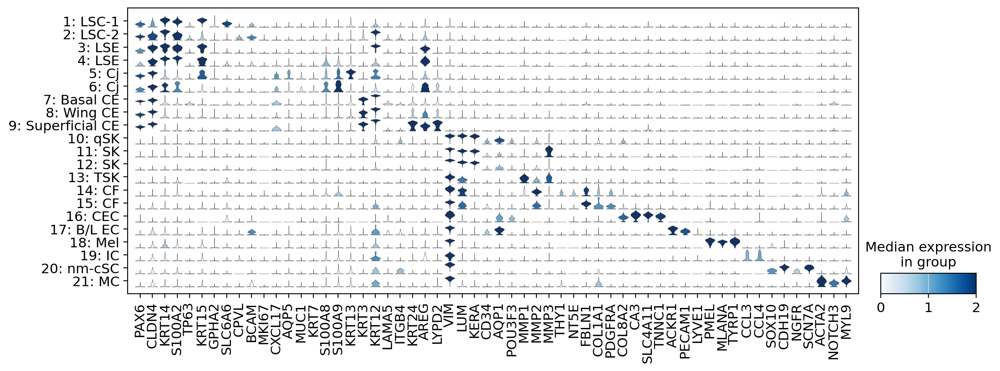

In [7]:
sc.set_figure_params(dpi=100, dpi_save=100) # Small note: 400 has been selected for the publication
sc.pl.stacked_violin(test_obj, markers, groupby="latest",vmax=2,figsize=[13,4.5],var_group_rotation=45)

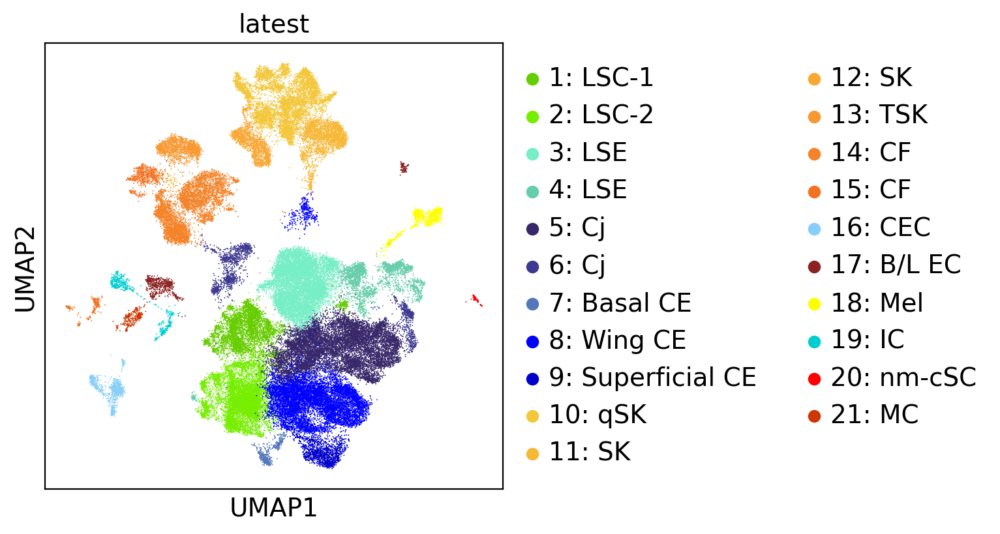

In [8]:
sc.set_figure_params(figsize=(4.5, 4.5), dpi=100, fontsize=14) # Small note: 400 has been selected for the publication

name_list= ['1: LSC-1',
 '2: LSC-2',
 '3: LSE',
 '4: LSE',
 '5: Cj',
 '6: Cj',
 '7: Basal CE',
 '8: Wing CE',
 '9: Superficial CE',
 '10: qSK',
 '11: SK',
 '12: SK',
 '13: TSK',
 '14: CF',
 '15: CF',
 '16: CEC',
 '17: B/L EC',
 '18: Mel',
 '19: IC',
 '20: nm-cSC',
 '21: MC']

col_list = ["#66CD00","#76EE00","#76EEC6","#66CDAA","#38286A","#3E3990","#5377BA","blue","mediumblue","#F3C739","#F7B837","#F9A834","#F79830","#F48329", #, #516BB2, #516BB2
"#F27221","#87CEFA","#8B2323","#FFFF00","#00CED1","#FF0000","#CD3700"]
	
col_dict = dict(zip(name_list,col_list))
colors=col_dict

test_obj.uns["latest_colors"] = [
    colors[cat] for cat in test_obj.obs["latest"].cat.categories
]

test_obj.obs["latest"] = test_obj.obs["latest"].astype("str")

sc.pl.umap(test_obj, color="latest",palette=colors, legend_fontsize=14)

In [9]:
dict_cellstates2={
    "1: LSC-1" : "1",
    "2: LSC-2" : "2",
    "3: LSE" : "3",
    "4: LSE" : "4",
    "5: Cj" : "5",
    "6: Cj" : "6",
    "7: Basal CE" : "7",
    "8: Wing CE" : "8",
    "9: Superficial CE" : "9",
    "10: qSK" : "10",
    "11: SK" : "11",
    "12: SK" : "12",
    "13: TSK" : "13",
    "14: CF" : "14",
    "15: CF" : "15",
    "16: CEC" : "16",
    "17: B/L EC" : "17",
    "18: Mel" : "18",
    "19: IC" : "19",
    "20: nm-cSC" : "20",
    "21: MC" : "21"
    }
set(list(dict_cellstates2.values()))

col_list = ["#66CD00","#76EE00","#76EEC6","#66CDAA","#38286A","#3E3990","#5377BA","blue","mediumblue","#F3C739","#F7B837","#F9A834","#F79830","#F48329", #, #516BB2, #516BB2
"#F27221","#87CEFA","#8B2323","#FFFF00","#00CED1","#FF0000","#CD3700"]
	
col_dict = dict(zip(name_list,col_list))
colors=col_dict

test_obj.obs["clusters"] = test_obj.obs["latest"].cat.rename_categories(dict_cellstates2)

from natsort import natsorted
test_obj.obs["clusters"] = test_obj.obs["clusters"].cat.reorder_categories(natsorted(test_obj.obs["clusters"].cat.categories))

test_obj.obs["clusters"].unique()

['5', '10', '2', '8', '1', ..., '7', '12', '16', '4', '13']
Length: 21
Categories (21, object): ['1', '2', '3', '4', ..., '18', '19', '20', '21']

<Axes: title={'center': 'clusters'}, xlabel='UMAP1', ylabel='UMAP2'>

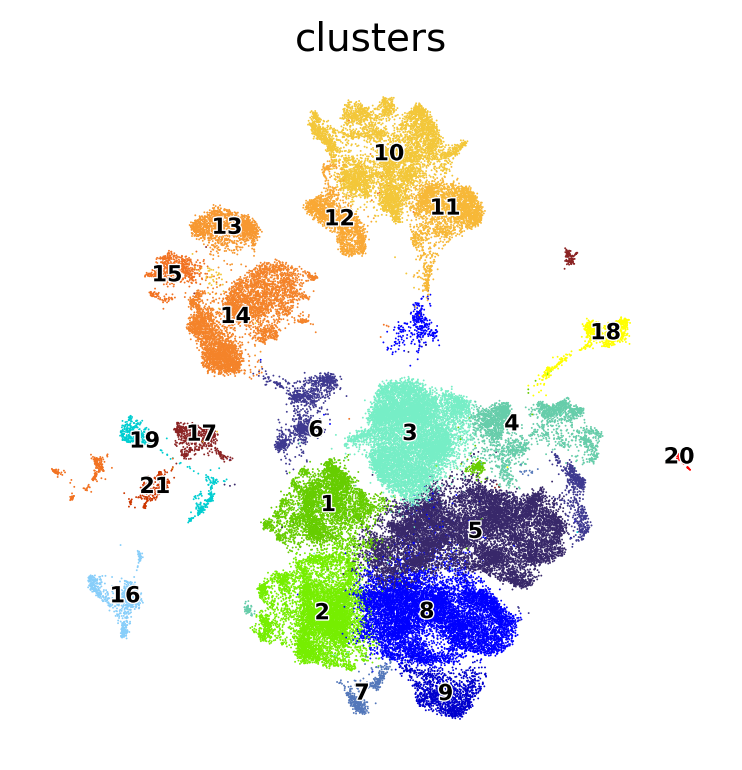

In [10]:
name_list= ['1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '20',
 '21']
col_list = ["#66CD00","#76EE00","#76EEC6","#66CDAA","#38286A","#3E3990","#5377BA","blue","mediumblue","#F3C739","#F7B837","#F9A834","#F79830","#F48329", #, #516BB2, #516BB2
"#F27221","#87CEFA","#8B2323","#FFFF00","#00CED1","#FF0000","#CD3700"]
	
col_dict = dict(zip(name_list,col_list))
colors=col_dict
sc.pl.umap(test_obj, color="clusters",palette=colors, legend_fontsize=8, legend_loc="on data", legend_fontoutline=1, frameon=False, show=False)

# Harmopy integration (Harmonypy)

In [11]:
# Use harmonypy (https://github.com/slowkow/harmonypy)
import pandas as pd

meta_data = test_obj.obs[["latest","Condition"]].copy()
vars_use = ['Condition']

In [ ]:
#! uv pip install harmonypy

Using Python 3.11.10 environment at: /home/jarts/.conda/envs/latestscanpy
Resolved 11 packages in 288ms                                        
⠙ Preparing packages... (0/1)                                                   
⠙ Preparing packages... (0/1)----     0 B/20.40 KiB                     
⠙ Preparing packages... (0/1)---- 16.00 KiB/20.40 KiB                   
Prepared 1 package in 11ms                                                   
Installed 1 package in 16ms                                 
 + harmonypy==0.0.10


In [37]:
sc.pp.pca(test_obj)

In [38]:
data_mat = test_obj.obsm['X_pca'].copy()

In [39]:
data_mat.shape

(65036, 50)

In [40]:
import harmonypy as hm
ho = hm.run_harmony(data_mat, meta_data, vars_use)

2025-04-30 14:53:32,713 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-30 14:53:37,639 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-30 14:53:37,858 - harmonypy - INFO - Iteration 1 of 10
2025-04-30 14:53:48,103 - harmonypy - INFO - Iteration 2 of 10
2025-04-30 14:53:59,806 - harmonypy - INFO - Iteration 3 of 10
2025-04-30 14:54:10,672 - harmonypy - INFO - Converged after 3 iterations


In [41]:
res = pd.DataFrame(ho.Z_corr)
res = res.to_numpy()
res = res.T
res

array([[ -8.773594  ,  -4.2818236 ,  -0.7022426 , ...,   2.2704072 ,
         -1.3533261 ,   0.43296787],
       [ -6.7289367 ,  -9.4950695 ,   2.9496765 , ...,   1.7905654 ,
         -0.49020642,   1.0037149 ],
       [ -6.87521   ,  -0.5368365 ,  -0.70428276, ...,   1.5866578 ,
          0.68951154,   0.46602243],
       ...,
       [  3.8945239 ,   0.8746984 , -13.252658  , ...,  -0.48131406,
          0.19321127,   0.15438132],
       [ -0.8935921 ,   5.1267304 , -10.403241  , ...,   0.17877822,
         -0.9852971 ,   1.2806655 ],
       [ 15.700141  ,  -4.631488  ,  -5.907572  , ...,   1.2008406 ,
         -0.26466367,  -1.6217923 ]], dtype=float32)

/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


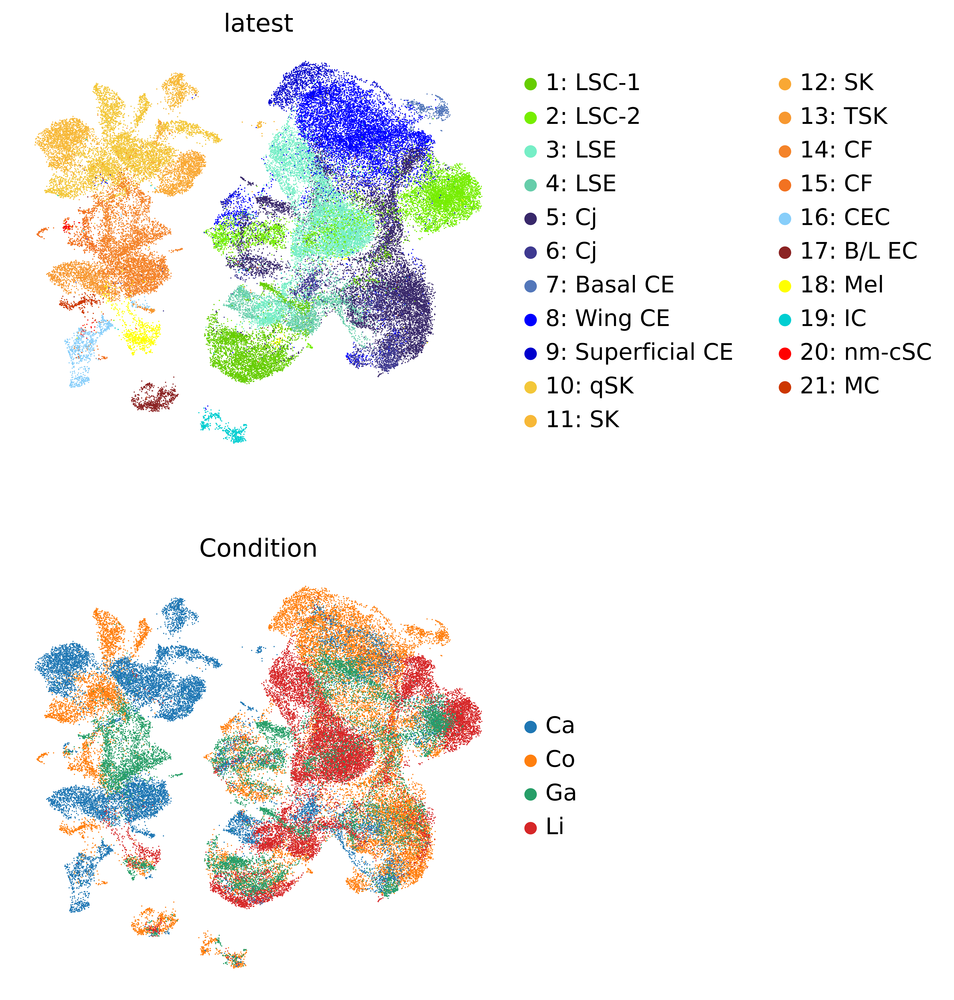

In [42]:
test_obj.obsm['X_pca'] = res
sc.pp.neighbors(test_obj, use_rep='X_pca', n_neighbors=10, n_pcs=30)
sc.tl.umap(test_obj, random_state=42)
sc.pl.umap(test_obj, color=['latest',"Condition"], frameon=False, ncols=1)

In [45]:
sc.pl.umap(test_obj, color=['latest',"Condition"], frameon=False, ncols=1, save='umap_harmony.pdf', show=False)

[<Axes: title={'center': 'latest'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'Condition'}, xlabel='UMAP1', ylabel='UMAP2'>]

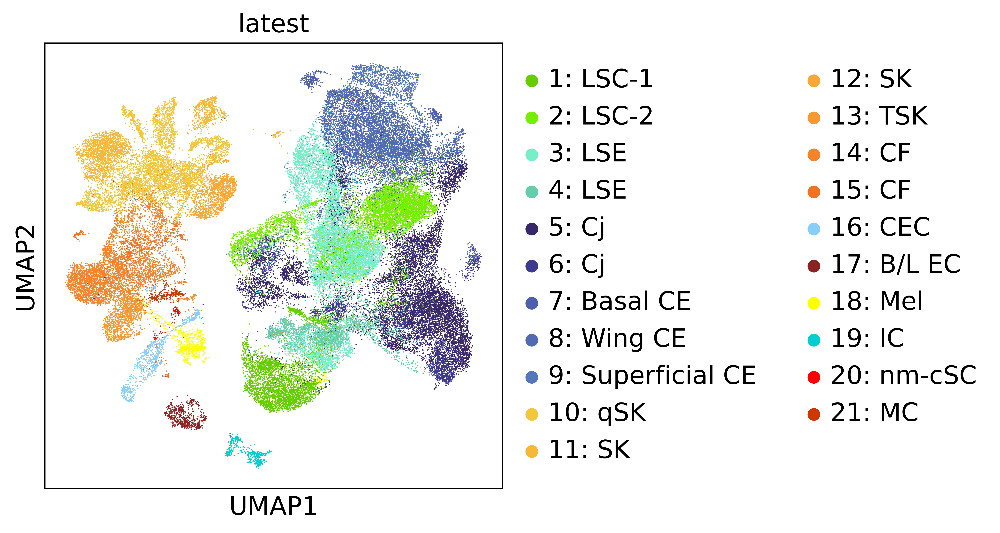

In [16]:
name_list= ['1: LSC-1',
 '2: LSC-2',
 '3: LSE',
 '4: LSE',
 '5: Cj',
 '6: Cj',
 '7: Basal CE',
 '8: Wing CE',
 '9: Superficial CE',
 '10: qSK',
 '11: SK',
 '12: SK',
 '13: TSK',
 '14: CF',
 '15: CF',
 '16: CEC',
 '17: B/L EC',
 '18: Mel',
 '19: IC',
 '20: nm-cSC',
 '21: MC']

col_list = ["#66CD00","#76EE00","#76EEC6","#66CDAA","#38286A","#3E3990","#4E60AB","#516BB2","#5377BA","#F3C739","#F7B837","#F9A834","#F79830","#F48329",
"#F27221","#87CEFA","#8B2323","#FFFF00","#00CED1","#FF0000","#CD3700"]
	
col_dict = dict(zip(name_list,col_list))
colors=col_dict

test_obj.uns["latest_colors"] = [
    colors[cat] for cat in test_obj.obs["latest"].cat.categories
]

test_obj.obs["latest"] = test_obj.obs["latest"].astype("str")

sc.pl.umap(test_obj, color="latest",palette=colors, legend_fontsize=14)

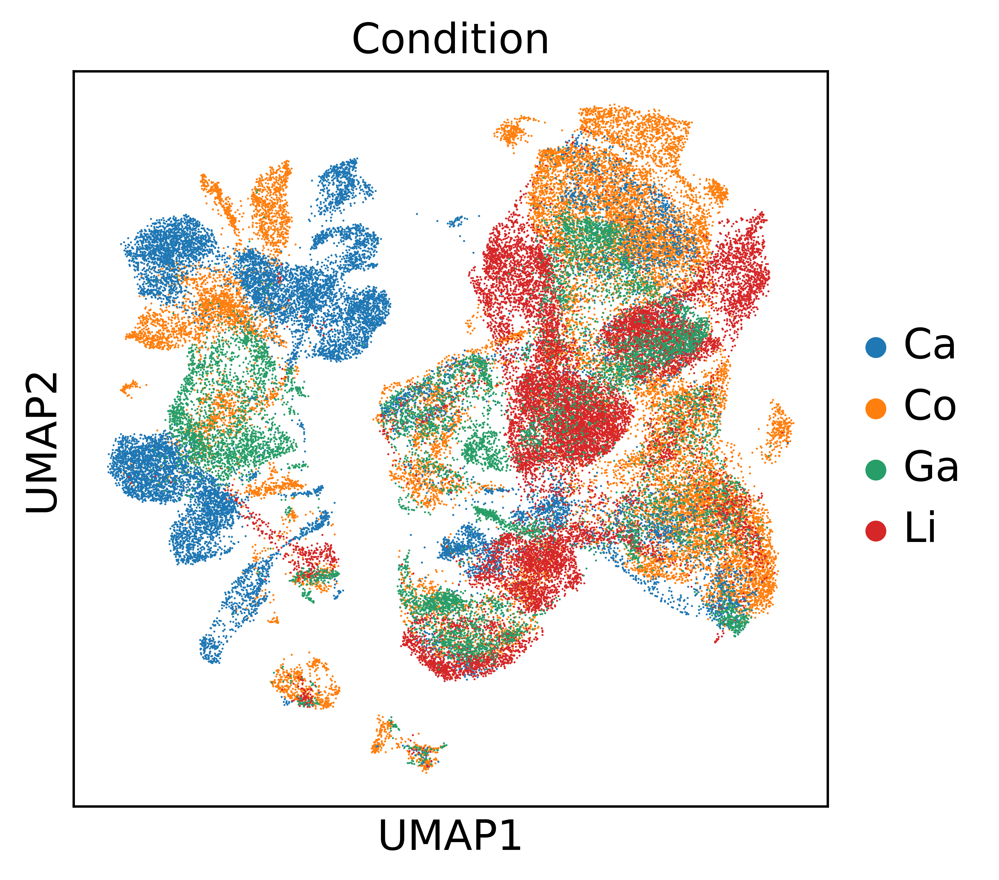

In [17]:
sc.pl.umap(test_obj, color="Condition", legend_fontsize=14)

In [18]:
test_obj.obs["Condition"].unique()

['Co', 'Ca', 'Li', 'Ga']
Categories (4, object): ['Ca', 'Co', 'Ga', 'Li']

In [19]:
# Count the number of cells per condition
test_obj.obs["Condition"].value_counts()

Condition
Co    22276
Li    16609
Ca    15903
Ga    10248
Name: count, dtype: int64

In [43]:
data = [
    {'Study': 'Collin et al.', 'Number of Donor Corneas': 6, 'Specific Regions': 'Limbal ring, Central cornea, Complete corneas', 'Number of cells': 22276, 'Additional Data':'scATAC-seq'},
    {'Study': 'Català et al.', 'Number of Donor Corneas': 8, 'Specific Regions': 'Limbal ring (2), Complete corneas (6)', 'Number of cells': 15903, 'Additional Data': '-'},
    {'Study': 'Gautam et al.', 'Number of Donor Corneas': 3, 'Specific Regions': 'Cornea data included', 'Number of cells': 10248, 'Additional Data': '-'},
    {'Study': 'Li et al.', 'Number of Donor Corneas': 4, 'Specific Regions': 'Limbus (after removing central cornea and superficial layers)', 'Number of cells': 16609, 'Additional Data': '-'},
]

df = pd.DataFrame(data)
df

,Study,Number of Donor Corneas,Specific Regions,Number of cells,Additional Data
0,Collin et al.,6,"Limbal ring, Central cornea, Complete corneas",22276,scATAC-seq
1,Català et al.,8,"Limbal ring (2), Complete corneas (6)",15903,-
2,Gautam et al.,3,Cornea data included,10248,-
3,Li et al.,4,Limbus (after removing central cornea and supe...,16609,-


In [41]:
def latex_with_adjustbox_markers(df, *args, **kwargs):
    kwargs['column_format'] = '|'.join([''] + ['l'] * df.index.nlevels
                                            + ['r'] * df.shape[1] + [''])
    res = df.to_latex(*args, **kwargs)
    res = res.replace('\\begin{tabular}{|l|r|r|r|r|r|}\n', '\\begin{table}\n\\begin{adjustbox}{scale=0.95,center}\n\\begin{tabular}{|l|r|r|r|r|r|}\n\hline\n')
    res = res.replace('\end{tabular}\n', '\hline\n\end{tabular}\n\end{adjustbox}\n\end{table}\n')
    for i in markers:
        res = res.replace(str(i), str('\\textbf '+ '{' + i + '}'))

    return res

In [42]:
print(latex_with_adjustbox_markers(df))

\begin{table}
\begin{adjustbox}{scale=0.95,center}
\begin{tabular}{|l|r|r|r|r|r|}
\hline
\toprule
 & Study & Number of Donor Corneas & Specific Regions & Number of cells & Additional Data \\
\midrule
0 & Collin et al. & 6 & Limbal ring, Central cornea, Complete corneas & 22276 & scATAC-seq \\
1 & Català et al. & 8 & Limbal ring (2), Complete corneas (6) & 15903 & - \\
2 & Gautam et al. & 3 & Cornea data included & 10248 & - \\
3 & Li et al. & 4 & Limbus (after removing central cornea and superficial layers) & 15903 & - \\
\bottomrule
\hline
\end{tabular}
\end{adjustbox}
\end{table}



# Progeny analysis

In [1]:
import scanpy as sc
import numpy as np

/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_hdf from `anndata` is deprecated. Import anndata.io.read_hdf instead.
  warnings.warn(msg, FutureWarning)
/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarn

In [2]:
# Perform PROGENy analysis on latest object
import decoupler as dc

# Plotting options, change to your liking
sc.settings.set_figure_params(dpi=300, frameon=False)
sc.set_figure_params(dpi=300)
sc.set_figure_params(figsize=(4, 4))

/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
#! uv pip install decoupler

In [3]:
progeny = dc.get_progeny(organism='human', top=500)
progeny

,source,target,weight,p_value
0,Androgen,TMPRSS2,11.490631,0.0
1,Androgen,NKX3-1,10.622551,0.0
2,Androgen,MBOAT2,10.472733,0.0
3,Androgen,KLK2,10.176186,0.0
4,Androgen,SARG,11.386852,0.0
...,...,...,...,...
6995,p53,ZMYM4,-2.325752,0.000002
6996,p53,CFDP1,-1.628168,0.000002
6997,p53,VPS37D,2.309503,0.000002
6998,p53,TEDC1,-2.274823,0.000002


In [4]:
# load in latest object
test_obj = sc.read_h5ad("/mnt/d/surfdrive/radboud/papers/metaatlas/corneal_cell_state_meta_atlas.h5ad")
test_obj

AnnData object with n_obs × n_vars = 65036 × 27656
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'donors', 'leiden_anno', 'batch', 'leiden', 'leiden_renamed'
    var: 'features'
    uns: 'batch_colors', 'leiden_colors'

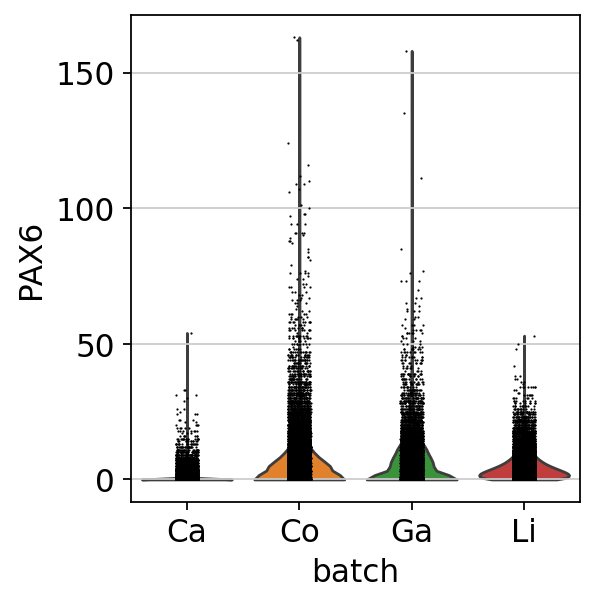

In [6]:
sc.pl.violin(test_obj, "PAX6", groupby="batch", use_raw=False)

In [7]:
sc.pp.normalize_per_cell(test_obj, counts_per_cell_after=1e4)

# logaritmize
sc.pp.log1p(test_obj)

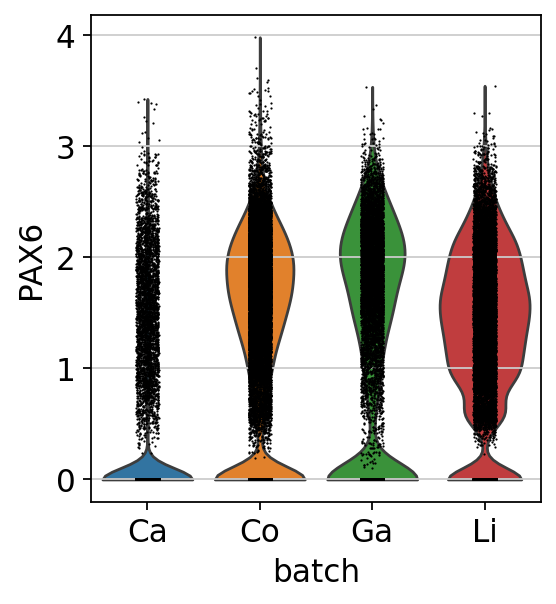

In [8]:
sc.pl.violin(test_obj, "PAX6", groupby="batch", use_raw=False)

In [9]:
dc.run_mlm(
    mat=test_obj,
    net=progeny,
    source='source',
    target='target',
    weight='weight',
    verbose=True,
    use_raw=False
)

97 features of mat are empty, they will be removed.
Running mlm on mat with 65036 samples and 27559 targets for 14 sources.


100%|██████████| 7/7 [00:46<00:00,  6.59s/it]


In [10]:
test_obj.obsm['mlm_estimate']

,Androgen,EGFR,Estrogen,Hypoxia,JAK-STAT,MAPK,NFkB,PI3K,TGFb,TNFa,Trail,VEGF,WNT,p53
Collin_SRR12386359_AAACGAACAAGTTCGT-1,2.040072,1.339012,-2.878691,4.762332,1.287335,-2.965158,-2.173171,-5.004415,3.138435,3.053666,-2.110647,-0.596965,-1.063840,-5.521101
Collin_SRR12386359_AAACGAACATCAGTGT-1,2.980496,2.635785,-5.193175,1.921646,3.704817,-5.340608,-2.541369,-4.427722,2.315217,3.659751,-1.178922,-1.632381,-0.568175,-5.204778
Collin_SRR12386359_AAACGAATCGCCTTTG-1,1.124471,0.673131,-2.643456,3.665034,1.879823,-3.462448,-3.532442,-4.566833,1.796256,3.687329,-1.089788,-0.343403,-1.015230,-5.383517
Collin_SRR12386359_AAACGAATCTCGCTTG-1,4.343388,3.672416,0.870955,12.016255,2.201157,1.220035,2.952731,-4.141809,5.054039,0.462624,-3.761494,-0.721411,-0.548405,-5.761261
Collin_SRR12386359_AAACGCTAGCCTATTG-1,1.683699,2.129633,-1.389842,5.333549,-1.003454,-3.240187,-0.171479,-1.937841,1.559803,0.459141,-1.961623,-0.372627,-1.036604,-7.582952
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1,7.009130,-0.672323,-0.717968,9.462422,1.692561,2.915069,3.144293,-1.164645,4.807253,-1.408218,-3.946665,-0.221064,-1.633587,-3.359726
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1,2.577135,-0.161887,-2.153509,7.779092,2.568521,-1.166842,0.142902,-3.453066,-0.261318,0.122288,-3.177789,-1.171646,0.543495,-8.277333
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1,4.699326,-1.117497,-0.269378,6.724587,2.780910,-0.167098,-0.538641,-2.610383,2.936741,0.977265,-3.745083,0.579681,0.406926,-8.445233
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1,3.142252,-1.576283,-0.563435,5.734201,0.634283,1.085918,0.681254,-4.516343,2.188344,0.069779,-4.053029,0.582641,0.682182,-7.486823


In [11]:
test_obj.obsm['progeny_mlm_estimate'] = test_obj.obsm['mlm_estimate'].copy()
test_obj.obsm['progeny_mlm_pvals'] = test_obj.obsm['mlm_pvals'].copy()
test_obj

AnnData object with n_obs × n_vars = 65036 × 27656
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'donors', 'leiden_anno', 'batch', 'leiden', 'leiden_renamed', 'n_counts'
    var: 'features'
    uns: 'batch_colors', 'leiden_colors', 'log1p'
    obsm: 'mlm_estimate', 'mlm_pvals', 'progeny_mlm_estimate', 'progeny_mlm_pvals'

In [12]:
dict_cellstates={
    "1: LSC": "1: LSC-1",
    "2: LESC": "2: LSC-2",
    "3: LE": "3: LSE",
    "4: LE": "4: LSE",
    "5: Cj": "5: Cj",
    "6: Cj": "6: Cj",
    "7: CE": "8: Wing CE",
    "8: CE": "9: Superficial CE",
    "9: CE": "7: Basal CE",
    "10: qSK": "10: qSK",
    "11: SK": "11: SK",
    "12: SK": "12: SK",
    "13: TSK": "13: TSK",
    "14: CF": "14: CF",
    "15: CF": "15: CF",
    "16: EC": "16: CEC",
    "17: Ves": "17: B/L EC",
    "18: Mel": "18: Mel",
    "19: IC": "19: IC",
    "20: nm-cSC": "20: nm-cSC",
    "21: MC": "21: MC"
    }
set(list(dict_cellstates.values()))

test_obj.obs["latest"] = test_obj.obs["leiden"].cat.rename_categories(dict_cellstates)

from natsort import natsorted
test_obj.obs["latest"] = test_obj.obs["latest"].cat.reorder_categories(natsorted(test_obj.obs["latest"].cat.categories))

test_obj.obs["latest"].unique()

['5: Cj', '10: qSK', '2: LSC-2', '8: Wing CE', '1: LSC-1', ..., '7: Basal CE', '12: SK', '16: CEC', '4: LSE', '13: TSK']
Length: 21
Categories (21, object): ['1: LSC-1', '2: LSC-2', '3: LSE', '4: LSE', ..., '18: Mel', '19: IC', '20: nm-cSC', '21: MC']

In [ ]:
# Join similar cell states together
dict_cellstates={
    "1: LSC-1": "LSC-1",
    "2: LSC-2": "LSC-2",
    "3: LSE": "LSE",
    "4: LSE": "LSE",
    "5: Cj": "Cj",
    "6: Cj": "Cj",
    "7: Basal CE": "CE",
    "8: Wing CE": "CE",
    "9: Superficial CE": "CE",
    "10: qSK": "qSK",
    "11: SK": "SK",
    "12: SK": "SK",
    "13: TSK": "TSK",
    "14: CF": "CF",
    "15: CF": "CF",
    "16: CEC": "CEC",
    "17: B/L EC": "B/L EC",
    "18: Mel": "Mel",
    "19: IC": "IC",
    "20: nm-cSC": "nm-cSC",
    "21: MC": "MC"
    }

test_obj.obs["latestjoined"] = test_obj.obs["latest"].map(dict_cellstates)
test_obj.obs["latestjoined"] = test_obj.obs["latestjoined"].astype("category")
test_obj.obs["latestjoined"] = test_obj.obs["latestjoined"].cat.set_categories(['LSC-1',
 'LSC-2',
 'LSE',
 'Cj',
 'CE',
 'qSK',
 'SK',
 'TSK',
 'CF',
 'CEC',
 'B/L EC',
 'Mel',
 'IC',
 'nm-cSC',
 'MC'])

test_obj.obs["latestjoined"]

Collin_SRR12386359_AAACGAACAAGTTCGT-1       Cj
Collin_SRR12386359_AAACGAACATCAGTGT-1       Cj
Collin_SRR12386359_AAACGAATCGCCTTTG-1       Cj
Collin_SRR12386359_AAACGAATCTCGCTTG-1      qSK
Collin_SRR12386359_AAACGCTAGCCTATTG-1    LSC-2
                                         ...  
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1       CF
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1    LSC-1
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1    LSC-1
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1    LSC-1
Gautam_SRR14742511_TTTGTTGTCGGAGTAG-1       CF
Name: latestjoined, Length: 65036, dtype: category
Categories (15, object): ['LSC-1', 'LSC-2', 'LSE', 'Cj', ..., 'Mel', 'IC', 'nm-cSC', 'MC']

In [14]:
acts = dc.get_acts(test_obj, obsm_key='mlm_estimate')
acts

AnnData object with n_obs × n_vars = 65036 × 14
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'donors', 'leiden_anno', 'batch', 'leiden', 'leiden_renamed', 'n_counts', 'latest', 'latestjoined'
    uns: 'batch_colors', 'leiden_colors', 'log1p'
    obsm: 'mlm_estimate', 'mlm_pvals', 'progeny_mlm_estimate', 'progeny_mlm_pvals'

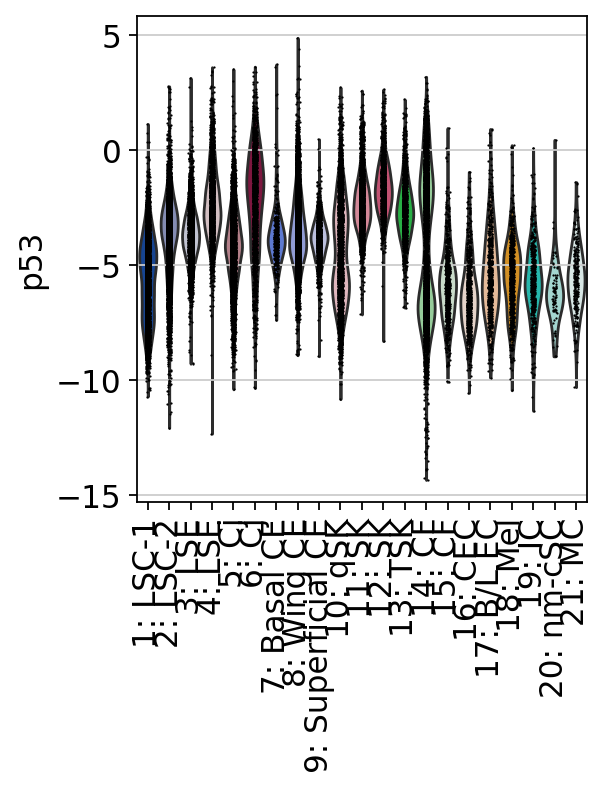

In [15]:
sc.pl.violin(acts, keys=['p53'], groupby='latest', rotation=90)

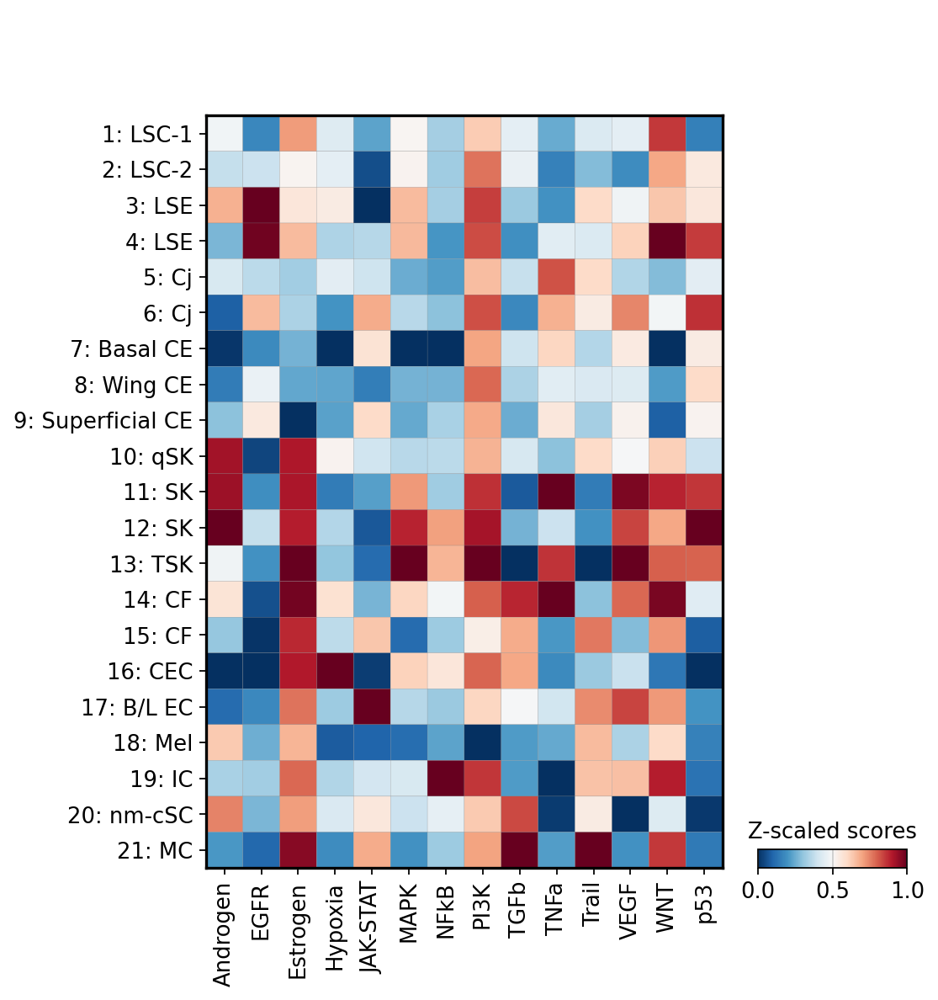

In [16]:
# Standard_scale "var" sets the original progeny scores between 0 and 1 to highlight the differences better
sc.pl.matrixplot(acts, var_names=acts.var_names, groupby='latest', dendrogram=False, standard_scale='var',
                 colorbar_title='Z-scaled scores', cmap='RdBu_r')

In [17]:
acts.var_names

Index(['Androgen', 'EGFR', 'Estrogen', 'Hypoxia', 'JAK-STAT', 'MAPK', 'NFkB',
       'PI3K', 'TGFb', 'TNFa', 'Trail', 'VEGF', 'WNT', 'p53'],
      dtype='object')

In [18]:
# Standard_scale "var" sets the original progeny scores between 0 and 1 to highlight the differences better
sc.pl.matrixplot(acts, var_names=["PI3K","WNT","p53","Trail","EGFR","TNFa","Estrogen","Androgen","MAPK","Hypoxia","VEGF","JAK-STAT","NFkB","TGFb"], groupby='latestjoined', dendrogram=False, standard_scale='var',
                 colorbar_title='Z-scaled scores', cmap='RdBu_r', swap_axes=True, save='progeny_matrixplot_0605.pdf', show=False)

{'mainplot_ax': <Axes: >,
 'color_legend_ax': <Axes: title={'center': 'Z-scaled scores'}>}

# Reconstructing the adata object (into parquet for the interactive dashboard)

In [1]:
import numpy as np
import scanpy as sc 

from anansescanpy import *

In [2]:
test_obj = sc.read_h5ad("/mnt/d/surfdrive/radboud/papers/metaatlas/corneal_cell_state_meta_atlas.h5ad")

In [3]:
test_obj.obs

,orig.ident,nCount_RNA,nFeature_RNA,donors,leiden_anno,batch,leiden,leiden_renamed
Collin_SRR12386359_AAACGAACAAGTTCGT-1,1,21239.0,4257,SRR12386359,Cj,Co,5: Cj,5: Cj
Collin_SRR12386359_AAACGAACATCAGTGT-1,1,21049.0,4207,SRR12386359,Cj,Co,5: Cj,5: Cj
Collin_SRR12386359_AAACGAATCGCCTTTG-1,1,13206.0,3061,SRR12386359,Cj,Co,5: Cj,5: Cj
Collin_SRR12386359_AAACGAATCTCGCTTG-1,1,21188.0,4084,SRR12386359,qSK,Co,10: qSK,10: qSK
Collin_SRR12386359_AAACGCTAGCCTATTG-1,1,15230.0,3058,SRR12386359,LESC,Co,2: LESC,2: LSC-2
...,...,...,...,...,...,...,...,...
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1,2,5251.0,2143,SRR14742511,CF,Ga,15: CF,15: CF
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1,2,7148.0,2194,SRR14742511,LSC,Ga,1: LSC,1: LSC-1
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1,2,6107.0,2284,SRR14742511,LSC,Ga,1: LSC,1: LSC-1
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1,2,17377.0,4279,SRR14742511,LSC,Ga,1: LSC,1: LSC-1


In [6]:
dict_cellstates={
    "1: LSC": "1: LSC-1",
    "2: LESC": "2: LSC-2",
    "3: LE": "3: LSE",
    "4: LE": "4: LSE",
    "5: Cj": "5: Cj",
    "6: Cj": "6: Cj",
    "7: CE": "8: Wing CE",
    "8: CE": "9: Superficial CE",
    "9: CE": "7: Basal CE",
    "10: qSK": "10: qSK",
    "11: SK": "11: SK",
    "12: SK": "12: SK",
    "13: TSK": "13: TSK",
    "14: CF": "14: CF",
    "15: CF": "15: CF",
    "16: EC": "16: CEC",
    "17: Ves": "17: B/L EC",
    "18: Mel": "18: Mel",
    "19: IC": "19: IC",
    "20: nm-cSC": "20: nm-cSC",
    "21: MC": "21: MC"
    }
set(list(dict_cellstates.values()))

test_obj.obs["latest"] = test_obj.obs["leiden"].cat.rename_categories(dict_cellstates)

from natsort import natsorted
test_obj.obs["latest"] = test_obj.obs["latest"].cat.reorder_categories(natsorted(test_obj.obs["latest"].cat.categories))

test_obj.obs["latest"].unique()

['5: Cj', '10: qSK', '2: LSC-2', '8: Wing CE', '1: LSC-1', ..., '7: Basal CE', '12: SK', '16: CEC', '4: LSE', '13: TSK']
Length: 21
Categories (21, object): ['1: LSC-1', '2: LSC-2', '3: LSE', '4: LSE', ..., '18: Mel', '19: IC', '20: nm-cSC', '21: MC']

In [7]:
# Join similar cell states together
dict_cellstates={
    "1: LSC-1": "LSC-1",
    "2: LSC-2": "LSC-2",
    "3: LSE": "LSE",
    "4: LSE": "LSE",
    "5: Cj": "Cj",
    "6: Cj": "Cj",
    "7: Basal CE": "CE",
    "8: Wing CE": "CE",
    "9: Superficial CE": "CE",
    "10: qSK": "qSK",
    "11: SK": "SK",
    "12: SK": "SK",
    "13: TSK": "TSK",
    "14: CF": "CF",
    "15: CF": "CF",
    "16: CEC": "CEC",
    "17: B/L EC": "B/L EC",
    "18: Mel": "Mel",
    "19: IC": "IC",
    "20: nm-cSC": "nm-cSC",
    "21: MC": "MC"
    }

test_obj.obs["latestjoined"] = test_obj.obs["latest"].map(dict_cellstates)
test_obj.obs["latestjoined"] = test_obj.obs["latestjoined"].astype("category")
test_obj.obs["latestjoined"] = test_obj.obs["latestjoined"].cat.set_categories(['LSC-1',
 'LSC-2',
 'LSE',
 'Cj',
 'CE',
 'qSK',
 'SK',
 'TSK',
 'CF',
 'CEC',
 'B/L EC',
 'Mel',
 'IC',
 'nm-cSC',
 'MC'])

test_obj.obs["latestjoined"]

Collin_SRR12386359_AAACGAACAAGTTCGT-1       Cj
Collin_SRR12386359_AAACGAACATCAGTGT-1       Cj
Collin_SRR12386359_AAACGAATCGCCTTTG-1       Cj
Collin_SRR12386359_AAACGAATCTCGCTTG-1      qSK
Collin_SRR12386359_AAACGCTAGCCTATTG-1    LSC-2
                                         ...  
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1       CF
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1    LSC-1
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1    LSC-1
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1    LSC-1
Gautam_SRR14742511_TTTGTTGTCGGAGTAG-1       CF
Name: latestjoined, Length: 65036, dtype: category
Categories (15, object): ['LSC-1', 'LSC-2', 'LSE', 'Cj', ..., 'Mel', 'IC', 'nm-cSC', 'MC']

In [8]:
from anansescanpy import *

sc.set_figure_params(figsize=(5, 5))
show_influence = True
GOI = "PAX6"

adata = test_obj.copy()
adata.write('/mnt/d/surfdrive/Radboud/papers/metaatlas/cornea_v1_nonraw_beforeasc.h5ad')

if show_influence == True:
    del adata.uns
    #adata.uns=uns_colors
    adata2 = adata.copy()
    df=import_scanpy_scANANSE(anndata=adata2,cluster_id="latestjoined",
                       anansnake_inf_dir="anansescanpy_meta/",unified_contrast='hnESC')

    if not GOI in df.columns: ## check if GOI is in the influence df
        raise ValueError("GOI has no influence score in the analysed cell states: LSC, LESC, LE, CE, Cj, qSK and CF")
    print(df)



factor       AHR     ALX4        AR     ARNT     ARNTL     ASCL2      ATF1  \
CE      0.556452  0.00000  0.000000  0.00000  0.548387  0.564516  0.000000   
CF      0.952381  0.00000  0.849206  0.18254  0.000000  0.000000  0.000000   
Cj      0.557377  0.00000  0.000000  0.00000  0.229508  0.303279  0.000000   
LSC-1   0.525547  0.00000  0.262774  0.00000  0.248175  0.481752  0.343066   
LSC-2   0.664000  0.00000  0.000000  0.00000  0.352000  0.776000  0.184000   
LSE     0.657658  0.00000  0.000000  0.00000  0.612613  0.495495  0.180180   
qSK     0.904762  0.81746  0.000000  0.00000  0.357143  0.000000  0.000000   

factor      ATF2      ATF3      ATF4  ...    ZNF148    ZNF219     ZNF24  \
CE      0.000000  0.951613  0.427419  ...  0.000000  0.056452  0.677419   
CF      0.301587  0.920635  0.309524  ...  0.103175  0.000000  0.285714   
Cj      0.000000  0.959016  0.172131  ...  0.000000  0.000000  0.491803   
LSC-1   0.503650  0.970803  0.423358  ...  0.000000  0.240876  0.510949   


/home/jarts/.conda/envs/asc310/lib/python3.10/site-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


In [9]:
adata2.obs["PAX6_influence"]

Collin_SRR12386359_AAACGAACAAGTTCGT-1    0.844262
Collin_SRR12386359_AAACGAACATCAGTGT-1    0.844262
Collin_SRR12386359_AAACGAATCGCCTTTG-1    0.844262
Collin_SRR12386359_AAACGAATCTCGCTTG-1    0.000000
Collin_SRR12386359_AAACGCTAGCCTATTG-1    0.896000
                                           ...   
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1    0.000000
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1    0.934307
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1    0.934307
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1    0.934307
Gautam_SRR14742511_TTTGTTGTCGGAGTAG-1    0.000000
Name: PAX6_influence, Length: 65036, dtype: float64

In [10]:
adata2.obs

,orig.ident,nCount_RNA,nFeature_RNA,donors,leiden_anno,batch,leiden,leiden_renamed,latest,latestjoined,...,ZNF148_influence,ZNF219_influence,ZNF24_influence,ZNF274_influence,ZNF331_influence,ZNF394_influence,ZNF524_influence,ZNF652_influence,ZNF768_influence,ZNF784_influence
Collin_SRR12386359_AAACGAACAAGTTCGT-1,1,21239.0,4257,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAACATCAGTGT-1,1,21049.0,4207,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAATCGCCTTTG-1,1,13206.0,3061,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAATCTCGCTTG-1,1,21188.0,4084,SRR12386359,qSK,Co,10: qSK,10: qSK,10: qSK,qSK,...,0.087302,0.000000,0.436508,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000
Collin_SRR12386359_AAACGCTAGCCTATTG-1,1,15230.0,3058,SRR12386359,LESC,Co,2: LESC,2: LSC-2,2: LSC-2,LSC-2,...,0.000000,0.056000,0.512000,0.232000,0.096000,0.032000,0.120000,0.376,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1,2,5251.0,2143,SRR14742511,CF,Ga,15: CF,15: CF,15: CF,CF,...,0.103175,0.000000,0.285714,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1,2,7148.0,2194,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1,2,6107.0,2284,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1,2,17377.0,4279,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591


In [11]:
influence_TFs = adata2.obs.filter(like='_influence').columns.tolist()
influence_TFs

['AHR_influence',
 'ALX4_influence',
 'AR_influence',
 'ARNT_influence',
 'ARNTL_influence',
 'ASCL2_influence',
 'ATF1_influence',
 'ATF2_influence',
 'ATF3_influence',
 'ATF4_influence',
 'ATF6_influence',
 'ATF6B_influence',
 'ATF7_influence',
 'BACH1_influence',
 'BBX_influence',
 'BHLHE22_influence',
 'BHLHE40_influence',
 'BHLHE41_influence',
 'CEBPA_influence',
 'CEBPB_influence',
 'CEBPD_influence',
 'CEBPG_influence',
 'CLOCK_influence',
 'CREB3_influence',
 'CREB3L2_influence',
 'CREB5_influence',
 'CREBZF_influence',
 'CUX1_influence',
 'DDIT3_influence',
 'DMRTA2_influence',
 'E2F2_influence',
 'EGR1_influence',
 'EGR3_influence',
 'EGR4_influence',
 'EHF_influence',
 'ELF1_influence',
 'ELF3_influence',
 'ELF5_influence',
 'ELK3_influence',
 'ELK4_influence',
 'EMX2_influence',
 'ERF_influence',
 'ERG_influence',
 'ESR1_influence',
 'ETS1_influence',
 'ETS2_influence',
 'ETV1_influence',
 'ETV2_influence',
 'ETV3_influence',
 'ETV5_influence',
 'ETV6_influence',
 'FLI1_inf

In [12]:
import pandas as pd
df = pd.DataFrame(adata2.obs[influence_TFs])
df[influence_TFs] = df[influence_TFs].apply(pd.to_numeric)
df

,AHR_influence,ALX4_influence,AR_influence,ARNT_influence,ARNTL_influence,ASCL2_influence,ATF1_influence,ATF2_influence,ATF3_influence,ATF4_influence,...,ZNF148_influence,ZNF219_influence,ZNF24_influence,ZNF274_influence,ZNF331_influence,ZNF394_influence,ZNF524_influence,ZNF652_influence,ZNF768_influence,ZNF784_influence
Collin_SRR12386359_AAACGAACAAGTTCGT-1,0.557377,0.00000,0.000000,0.00000,0.229508,0.303279,0.000000,0.000000,0.959016,0.172131,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAACATCAGTGT-1,0.557377,0.00000,0.000000,0.00000,0.229508,0.303279,0.000000,0.000000,0.959016,0.172131,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAATCGCCTTTG-1,0.557377,0.00000,0.000000,0.00000,0.229508,0.303279,0.000000,0.000000,0.959016,0.172131,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAATCTCGCTTG-1,0.904762,0.81746,0.000000,0.00000,0.357143,0.000000,0.000000,0.396825,0.825397,0.174603,...,0.087302,0.000000,0.436508,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000
Collin_SRR12386359_AAACGCTAGCCTATTG-1,0.664000,0.00000,0.000000,0.00000,0.352000,0.776000,0.184000,0.448000,0.976000,0.496000,...,0.000000,0.056000,0.512000,0.232000,0.096000,0.032000,0.120000,0.376,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1,0.952381,0.00000,0.849206,0.18254,0.000000,0.000000,0.000000,0.301587,0.920635,0.309524,...,0.103175,0.000000,0.285714,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1,0.525547,0.00000,0.262774,0.00000,0.248175,0.481752,0.343066,0.503650,0.970803,0.423358,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1,0.525547,0.00000,0.262774,0.00000,0.248175,0.481752,0.343066,0.503650,0.970803,0.423358,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1,0.525547,0.00000,0.262774,0.00000,0.248175,0.481752,0.343066,0.503650,0.970803,0.423358,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591


In [13]:
adata.obs[influence_TFs] = df[influence_TFs]

/tmp/ipykernel_31198/4033637785.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs[influence_TFs] = df[influence_TFs]
/tmp/ipykernel_31198/4033637785.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs[influence_TFs] = df[influence_TFs]
/tmp/ipykernel_31198/4033637785.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmente

In [14]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,donors,leiden_anno,batch,leiden,leiden_renamed,latest,latestjoined,...,ZNF148_influence,ZNF219_influence,ZNF24_influence,ZNF274_influence,ZNF331_influence,ZNF394_influence,ZNF524_influence,ZNF652_influence,ZNF768_influence,ZNF784_influence
Collin_SRR12386359_AAACGAACAAGTTCGT-1,1,21239.0,4257,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAACATCAGTGT-1,1,21049.0,4207,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAATCGCCTTTG-1,1,13206.0,3061,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAATCTCGCTTG-1,1,21188.0,4084,SRR12386359,qSK,Co,10: qSK,10: qSK,10: qSK,qSK,...,0.087302,0.000000,0.436508,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000
Collin_SRR12386359_AAACGCTAGCCTATTG-1,1,15230.0,3058,SRR12386359,LESC,Co,2: LESC,2: LSC-2,2: LSC-2,LSC-2,...,0.000000,0.056000,0.512000,0.232000,0.096000,0.032000,0.120000,0.376,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1,2,5251.0,2143,SRR14742511,CF,Ga,15: CF,15: CF,15: CF,CF,...,0.103175,0.000000,0.285714,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1,2,7148.0,2194,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1,2,6107.0,2284,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1,2,17377.0,4279,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591


In [15]:
adata.write('/mnt/d/surfdrive/Radboud/papers/metaatlas/cornea_v1_nonraw_afterasc.h5ad')

In [17]:
os_path="d/surfdrive/" #"s/" #
test_obj2 = sc.read_h5ad(f'/mnt/{os_path}Radboud/papers/metaatlas/cornea_v1_nonraw.h5ad')
test_obj2

AnnData object with n_obs × n_vars = 65036 × 27656
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'RNA_snn_res.0.15', 'seurat_clusters', 'costum_clustering', 'Condition', 'pANN_0.25_0.06_1806', 'DF.classifications_0.25_0.06_1806', 'pANN_0.25_0.005_1289', 'DF.classifications_0.25_0.005_1289', 'RNA_snn_res.0.1', 'pANN_0.25_0.18_1347', 'DF.classifications_0.25_0.18_1347', 'pANN_0.25_0.14_831', 'DF.classifications_0.25_0.14_831', 'batch', '_scvi_batch', '_scvi_labels', 'leiden', 'leiden_0.0', 'leiden_0.05', 'leiden_0.1', 'leiden_0.15', 'leiden_0.2', 'leiden_0.25', 'leiden_0.3', 'leiden_0.35', 'leiden_0.4', 'leiden_0.45', 'leiden_0.5', 'leiden_0.55', 'leiden_0.6', 'leiden_0.65', 'leiden_0.7', 'leiden_0.75', 'leiden_0.8', 'leiden_0.85', 'leiden_0.9', 'leiden_0.95', 'leiden_anno', 'latest', 'latestjoined', 'AHR_influence', 'ALX4_influence', 'AR_influence', 'ARNT_influence', 'ARNTL_influence', 'ASCL2_influence', 'ATF1_influence'

In [21]:
adata.obsm["X_umap"] = test_obj2.obsm["X_umap"].copy()

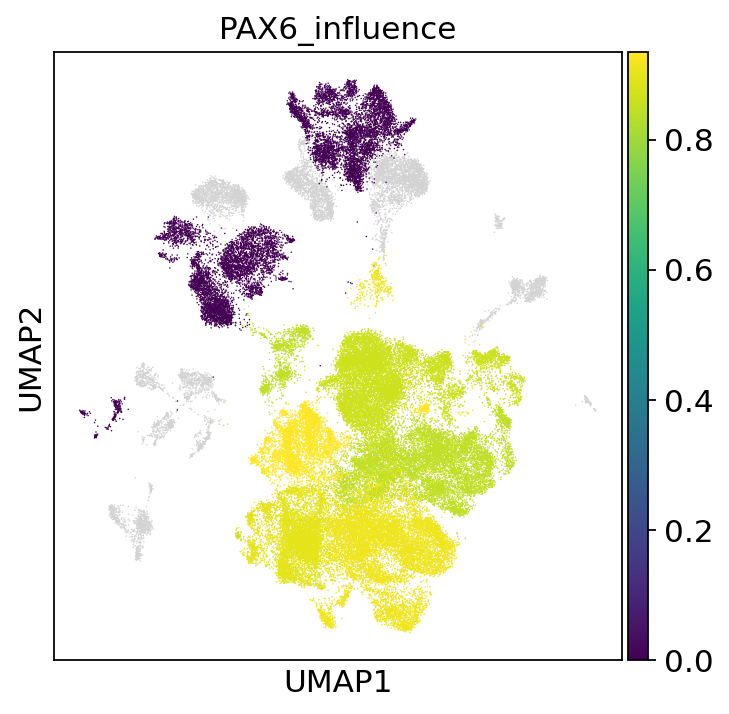

In [22]:
label_umap="latestjoined"
sc.pl.umap(
        adata,
        color="PAX6_influence")

In [23]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,donors,leiden_anno,batch,leiden,leiden_renamed,latest,latestjoined,...,ZNF148_influence,ZNF219_influence,ZNF24_influence,ZNF274_influence,ZNF331_influence,ZNF394_influence,ZNF524_influence,ZNF652_influence,ZNF768_influence,ZNF784_influence
Collin_SRR12386359_AAACGAACAAGTTCGT-1,1,21239.0,4257,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAACATCAGTGT-1,1,21049.0,4207,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAATCGCCTTTG-1,1,13206.0,3061,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.000000,0.000000,0.491803,0.000000,0.000000,0.000000,0.081967,0.000,0.188525,0.057377
Collin_SRR12386359_AAACGAATCTCGCTTG-1,1,21188.0,4084,SRR12386359,qSK,Co,10: qSK,10: qSK,10: qSK,qSK,...,0.087302,0.000000,0.436508,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000
Collin_SRR12386359_AAACGCTAGCCTATTG-1,1,15230.0,3058,SRR12386359,LESC,Co,2: LESC,2: LSC-2,2: LSC-2,LSC-2,...,0.000000,0.056000,0.512000,0.232000,0.096000,0.032000,0.120000,0.376,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1,2,5251.0,2143,SRR14742511,CF,Ga,15: CF,15: CF,15: CF,CF,...,0.103175,0.000000,0.285714,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1,2,7148.0,2194,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1,2,6107.0,2284,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1,2,17377.0,4279,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.000000,0.240876,0.510949,0.386861,0.167883,0.364964,0.000000,0.000,0.000000,0.087591


In [24]:
# Add log10genesperumi as well
all_genes=adata.var.index.to_list()
len(adata.var.index.to_list())
adata.obs["log10GenesPerUMI"] = np.log10(adata.obs["nFeature_RNA"]) / np.log10(adata.obs["nCount_RNA"])

/tmp/ipykernel_31198/3413996267.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs["log10GenesPerUMI"] = np.log10(adata.obs["nFeature_RNA"]) / np.log10(adata.obs["nCount_RNA"])


In [25]:
adata.obs["n_genes_by_counts"] = adata.obs["nFeature_RNA"]
adata.obs["total_counts"] = adata.obs["nCount_RNA"]

/tmp/ipykernel_31198/154568612.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs["n_genes_by_counts"] = adata.obs["nFeature_RNA"]
/tmp/ipykernel_31198/154568612.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs["total_counts"] = adata.obs["nCount_RNA"]


In [26]:
# Recalculate the pct_counts_mt, pct_counts_ribo and pct_counts_hemo
ribo_genes = adata.var_names.str.startswith(("RPS","RPL"))
print(sum(ribo_genes))
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
adata.obs['pct_counts_ribo'] = np.sum(
    adata[:, ribo_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1*100

101


/tmp/ipykernel_31198/2678724649.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs['pct_counts_ribo'] = np.sum(


In [27]:
# Recalculate the pct_counts_mt, pct_counts_ribo and pct_counts_hemo
hemo_genes = adata.var_names.str.contains("HB[^(P)]")
print(sum(hemo_genes))
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
adata.obs['pct_counts_hb'] = np.sum(
    adata[:, hemo_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1*100

58


/tmp/ipykernel_31198/275687042.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs['pct_counts_hb'] = np.sum(


In [28]:
influence_TFs = adata.obs.filter(like='_influence').columns.tolist() # get a list that ends_with "influence" collist=adata.obs.filter(like='_influence').columns.tolist()
relevant_states = ["latest", "latestjoined"]

In [29]:
# Add more: "Could not find keys '[, 'latest_joined', #'G2M_score', 'S_score', 'doublet_scores'
# 'pct_counts_mt', 'phase', 'predicted_doublets']'
list_adata_cols = adata.obs.columns.tolist()
list_adata_cols

['orig.ident',
 'nCount_RNA',
 'nFeature_RNA',
 'donors',
 'leiden_anno',
 'batch',
 'leiden',
 'leiden_renamed',
 'latest',
 'latestjoined',
 'AHR_influence',
 'ALX4_influence',
 'AR_influence',
 'ARNT_influence',
 'ARNTL_influence',
 'ASCL2_influence',
 'ATF1_influence',
 'ATF2_influence',
 'ATF3_influence',
 'ATF4_influence',
 'ATF6_influence',
 'ATF6B_influence',
 'ATF7_influence',
 'BACH1_influence',
 'BBX_influence',
 'BHLHE22_influence',
 'BHLHE40_influence',
 'BHLHE41_influence',
 'CEBPA_influence',
 'CEBPB_influence',
 'CEBPD_influence',
 'CEBPG_influence',
 'CLOCK_influence',
 'CREB3_influence',
 'CREB3L2_influence',
 'CREB5_influence',
 'CREBZF_influence',
 'CUX1_influence',
 'DDIT3_influence',
 'DMRTA2_influence',
 'E2F2_influence',
 'EGR1_influence',
 'EGR3_influence',
 'EGR4_influence',
 'EHF_influence',
 'ELF1_influence',
 'ELF3_influence',
 'ELF5_influence',
 'ELK3_influence',
 'ELK4_influence',
 'EMX2_influence',
 'ERF_influence',
 'ERG_influence',
 'ESR1_influence',
 

In [40]:
adata.obs['S.Score'] = test_obj2.obs['S.Score'].copy()
adata.obs['G2M.Score'] = test_obj2.obs['G2M.Score'].copy()
adata.obs['Phase'] = test_obj2.obs['Phase'].copy()
adata.obs['predicted_doublets'] = test_obj2.obs['predicted_doublets'].copy()
adata.obs['pct_counts_mt'] = test_obj2.obs['percent.mt'].copy()
adata.obs['DF.classifications_0.25_0.06_1806'] = test_obj2.obs['DF.classifications_0.25_0.06_1806'].copy()
adata.obs['DF.classifications_0.25_0.005_1289'] = test_obj2.obs['DF.classifications_0.25_0.005_1289'].copy()
adata.obs['DF.classifications_0.25_0.18_1347'] = test_obj2.obs['DF.classifications_0.25_0.18_1347'].copy()
adata.obs['DF.classifications_0.25_0.14_831'] = test_obj2.obs['DF.classifications_0.25_0.14_831'].copy()



In [41]:
adata.obs['S_score'] = adata.obs['S.Score']
adata.obs['G2M_score'] = adata.obs['S.Score']
adata.obs['phase'] = adata.obs['Phase']

In [42]:
# joining into a single predicted_doublets column
cols = ['DF.classifications_0.25_0.06_1806','DF.classifications_0.25_0.005_1289','DF.classifications_0.25_0.18_1347', 'DF.classifications_0.25_0.14_831']
adata.obs["predicted_doublets"] = adata.obs[cols].apply(lambda x: ','.join(x.dropna()), axis=1)

print(adata.obs['predicted_doublets'])

adata.obs["predicted_doublets"] =adata.obs["predicted_doublets"].str.replace("NA", "").str.strip()
adata.obs["predicted_doublets"] =adata.obs["predicted_doublets"].str.replace(",", "").str.strip()

adata.obs['predicted_doublets']

Collin_SRR12386359_AAACGAACAAGTTCGT-1    Singlet,NA,NA,NA
Collin_SRR12386359_AAACGAACATCAGTGT-1    Singlet,NA,NA,NA
Collin_SRR12386359_AAACGAATCGCCTTTG-1    Singlet,NA,NA,NA
Collin_SRR12386359_AAACGAATCTCGCTTG-1    Singlet,NA,NA,NA
Collin_SRR12386359_AAACGCTAGCCTATTG-1    Singlet,NA,NA,NA
                                               ...       
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1    NA,NA,NA,Singlet
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1    NA,NA,NA,Singlet
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1    NA,NA,NA,Singlet
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1    NA,NA,NA,Singlet
Gautam_SRR14742511_TTTGTTGTCGGAGTAG-1    NA,NA,NA,Singlet
Name: predicted_doublets, Length: 65036, dtype: object


Collin_SRR12386359_AAACGAACAAGTTCGT-1    Singlet
Collin_SRR12386359_AAACGAACATCAGTGT-1    Singlet
Collin_SRR12386359_AAACGAATCGCCTTTG-1    Singlet
Collin_SRR12386359_AAACGAATCTCGCTTG-1    Singlet
Collin_SRR12386359_AAACGCTAGCCTATTG-1    Singlet
                                          ...   
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1    Singlet
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1    Singlet
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1    Singlet
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1    Singlet
Gautam_SRR14742511_TTTGTTGTCGGAGTAG-1    Singlet
Name: predicted_doublets, Length: 65036, dtype: object

In [43]:
del test_obj

In [44]:
del test_obj2

In [45]:
adata.write('/mnt/d/surfdrive/Radboud/papers/metaatlas/cornea_v1_pnas_nexus.h5ad')

In [1]:
# Move to new environment with newer version of scanpy (latestscanpy python 3.11)
import scanpy as sc
import numpy as np

/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_hdf from `anndata` is deprecated. Import anndata.io.read_hdf instead.
  warnings.warn(msg, FutureWarning)
/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/home/jarts/.conda/envs/latestscanpy/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarn

In [3]:
adata = sc.read_h5ad('/mnt/d/surfdrive/Radboud/papers/metaatlas/cornea_v1_pnas_nexus.h5ad')
influence_TFs = adata.obs.filter(like='_influence').columns.tolist() # get a list that ends_with "influence" collist=adata.obs.filter(like='_influence').columns.tolist()

# Rename columns and keep interesting ones
adata.obs["integrated_cell_states"] = adata.obs["latestjoined"]
adata.obs["integrated_clusters"] = adata.obs["latest"]
adata.obs["studies"] = adata.obs["batch"]


all_genes=adata.var.index.to_list()
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,donors,leiden_anno,batch,leiden,leiden_renamed,latest,latestjoined,...,G2M_score,phase,pct_counts_mt,DF.classifications_0.25_0.06_1806,DF.classifications_0.25_0.005_1289,DF.classifications_0.25_0.18_1347,DF.classifications_0.25_0.14_831,integrated_cell_states,integrated_clusters,studies
Collin_SRR12386359_AAACGAACAAGTTCGT-1,1,21239.0,4257,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.016198,S,10.038137,Singlet,NA,NA,NA,Cj,5: Cj,Co
Collin_SRR12386359_AAACGAACATCAGTGT-1,1,21049.0,4207,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,-0.035335,G1,9.572901,Singlet,NA,NA,NA,Cj,5: Cj,Co
Collin_SRR12386359_AAACGAATCGCCTTTG-1,1,13206.0,3061,SRR12386359,Cj,Co,5: Cj,5: Cj,5: Cj,Cj,...,0.036642,S,8.708163,Singlet,NA,NA,NA,Cj,5: Cj,Co
Collin_SRR12386359_AAACGAATCTCGCTTG-1,1,21188.0,4084,SRR12386359,qSK,Co,10: qSK,10: qSK,10: qSK,qSK,...,0.014364,G2M,4.195771,Singlet,NA,NA,NA,qSK,10: qSK,Co
Collin_SRR12386359_AAACGCTAGCCTATTG-1,1,15230.0,3058,SRR12386359,LESC,Co,2: LESC,2: LSC-2,2: LSC-2,LSC-2,...,-0.041253,G1,22.698621,Singlet,NA,NA,NA,LSC-2,2: LSC-2,Co
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Gautam_SRR14742511_TTTGGTTTCCGTAGGC-1,2,5251.0,2143,SRR14742511,CF,Ga,15: CF,15: CF,15: CF,CF,...,0.002502,S,1.466387,NA,NA,NA,Singlet,CF,15: CF,Ga
Gautam_SRR14742511_TTTGTTGAGGATGTTA-1,2,7148.0,2194,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.108062,S,18.102966,NA,NA,NA,Singlet,LSC-1,1: LSC-1,Ga
Gautam_SRR14742511_TTTGTTGCAGCCATTA-1,2,6107.0,2284,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,-0.045893,G1,26.494187,NA,NA,NA,Singlet,LSC-1,1: LSC-1,Ga
Gautam_SRR14742511_TTTGTTGTCCTATTTG-1,2,17377.0,4279,SRR14742511,LSC,Ga,1: LSC,1: LSC-1,1: LSC-1,LSC-1,...,0.075470,S,16.562122,NA,NA,NA,Singlet,LSC-1,1: LSC-1,Ga


In [5]:
adata.write('/mnt/d/surfdrive/Radboud/papers/metaatlas/cornea_v1_pnas_nexus.h5ad')

In [6]:
# run convertcma.py script